Get the raw data from Bear

In [110]:
import pandas as pd

raw_data = pd.read_csv("https://raw.githubusercontent.com/bear-revels/immo-eliza-scraping-Python_Pricers/main/data/all_property_details.csv")
# raw_data = pd.read_csv("https://github.com/gnadela/immoeliza-analysis/raw/main/src/cleaned_data.csv")


Function to check duplicates where id is different

In [10]:

def check_duplicates(df):
    # Check if DataFrame is empty or not provided
    if df.empty:
        print("Error: DataFrame is empty or not provided.")
        return None

    # Define the subset of columns to consider when checking for duplicates
    subset_cols = df.columns.difference(['ID', 'Property url'])

    # Check for duplicate entries based on all columns except 'ID' and 'Property url'
    duplicate_rows = df[df.duplicated(subset=subset_cols, keep=False)]

    # Save duplicate entries to CSV file
    if not duplicate_rows.empty:
        duplicate_rows.to_csv('duplicate_entries.csv', index=False)
        print("Duplicate entries saved to 'duplicate_entries.csv'.")
    else:
        print("No duplicate entries found.")

    return duplicate_rows


In [11]:
duplicate_entries = check_duplicates(raw_data)

Duplicate entries saved to 'duplicate_entries.csv'.


There are 500+ entries, not sure we should remove all.  I created a branch called check_duplicates in case we want to incorporate this.

Now trying Visualization......

In [98]:
import plotly.express as px
import pandas as pd

# Load data
# raw_data = pd.read_csv('../src/cleaned/cleaned_data.csv')
data = pd.DataFrame(raw_data)

# Filter data for PropertyType = 'HOUSE'
data = data[data['PropertyType'] == 'HOUSE']

# Calculate Price per Living Area
data['PricePerLivingArea'] = data['Price'] / data['LivingArea']

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(data, lat='Latitude', lon='Longitude', color='PricePerLivingArea',
                        color_continuous_scale='Plasma', size_max=6, zoom=7,
                        center=dict(lat=data['Latitude'].mean(), lon=data['Longitude'].mean()),
                        hover_name='PricePerLivingArea', title='HOUSE Price per Living Area',
                        range_color=[data['PricePerLivingArea'].quantile(0.1),
                                     data['PricePerLivingArea'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        hover_data={'City': True, 'Price': True, 'LivingArea': True})

# Update hover information to exclude latitude and longitude
fig.update_traces(hovertemplate='<b>City:</b> %{customdata[0]}<br><b>Price:</b> %{customdata[1]}<br><b>Living Area:</b> %{customdata[2]}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Price per Living Area')

# Show the plot
fig.show()

In [118]:
import plotly.express as px
import pandas as pd

# Assuming raw_data contains your dataset

# Filter data for PropertyType = 'HOUSE'
data = raw_data[raw_data['PropertyType'] == 'HOUSE']

# Group data by postal code and calculate median latitude, longitude, and prices
median_data = data.groupby('PostalCode').agg({'Latitude': 'median', 'Longitude': 'median', 'Price': 'median'}).reset_index()

# Count the number of properties per postal code
count_data = data.groupby('PostalCode').size().reset_index(name='PropertyCount')

# Merge median data with count data
merged_data = pd.merge(median_data, count_data, on='PostalCode')

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(merged_data, lat='Latitude', lon='Longitude', color='Price',
                        color_continuous_scale='Plasma', 
                        size='PropertyCount', 
                        zoom=7,
                        center=dict(lat=merged_data['Latitude'].mean(), lon=merged_data['Longitude'].mean()),
                        hover_name='PostalCode', title='Median HOUSE Price per Postal Code',
                        range_color=[merged_data['Price'].quantile(0.1), merged_data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['PostalCode', 'Price', 'PropertyCount'])

# Update hover information to include city and property count
fig.update_traces(hovertemplate='<b>Postal Code:</b> %{customdata[0]}<br>'
                                 '<b>Median Price:</b> %{customdata[1]:,.2f}<br>'
                                 '<b>Number of Properties:</b> %{customdata[2]}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Median HOUSE Price')

# Show the plot
fig.show()


In [119]:
import plotly.express as px
import pandas as pd

# Assuming raw_data contains your dataset

# Filter data for PropertyType
data = raw_data[raw_data['PropertyType'] == 'APARTMENT']

# Group data by postal code and calculate median latitude, longitude, and prices
median_data = data.groupby('PostalCode').agg({'Latitude': 'median', 'Longitude': 'median', 'Price': 'median'}).reset_index()

# Count the number of properties per postal code
count_data = data.groupby('PostalCode').size().reset_index(name='PropertyCount')

# Merge median data with count data
merged_data = pd.merge(median_data, count_data, on='PostalCode')

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(merged_data, lat='Latitude', lon='Longitude', color='Price',
                        color_continuous_scale='Plasma', 
                        size='PropertyCount', 
                        zoom=7,
                        center=dict(lat=merged_data['Latitude'].mean(), lon=merged_data['Longitude'].mean()),
                        hover_name='PostalCode', title='Median APARTMENT Price per Postal Code',
                        range_color=[merged_data['Price'].quantile(0.1), merged_data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['PostalCode', 'Price', 'PropertyCount'])

# Update hover information to include city and property count
fig.update_traces(hovertemplate='<b>Postal Code:</b> %{customdata[0]}<br>'
                                 '<b>Median Price:</b> %{customdata[1]:,.2f}<br>'
                                 '<b>Number of Properties:</b> %{customdata[2]}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Median APARTMENT Price')

# Show the plot
fig.show()


In [95]:
import plotly.express as px
import pandas as pd

# Assuming raw_data contains your dataset

# Filter data for PropertyType = 'HOUSE'
data = raw_data[raw_data['PropertyType'] == 'HOUSE']

# Group data by postal code and calculate the median latitude, longitude, and price
median_data = data.groupby('PostalCode').agg({'Latitude': 'median', 'Longitude': 'median', 'Price': 'median'}).reset_index()

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(median_data, lat='Latitude', lon='Longitude', color='Price',
                        color_continuous_scale='Plasma', size_max=6, zoom=7,
                        center=dict(lat=median_data['Latitude'].mean(), lon=median_data['Longitude'].mean()),
                        hover_name='Price', title='Median HOUSE Price per Postal Code',
                        range_color=[median_data['Price'].quantile(0.1),
                                     median_data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['PostalCode', 'Price'])
# Update hover information to exclude latitude and longitude
fig.update_traces(hovertemplate='<b>Postal Code:</b> %{customdata[0]}<br><b>Median Price:</b> %{customdata[1]}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Median HOUSE Price')

# Show the plot
fig.show()


In [107]:
import plotly.express as px
import pandas as pd


# Filter data for PropertyType = 'HOUSE'
data = raw_data[raw_data['PropertyType'] == 'HOUSE']

# Group data by postal code and calculate the median latitude, longitude, and price
grouped_data = data.groupby('PostalCode').agg({'Latitude': 'median', 'Longitude': 'median', 'Price': 'median', 'City': 'first', 'PropertyType': 'count'}).reset_index()

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(grouped_data, lat='Latitude', lon='Longitude', color='Price', size='PropertyType',
                        color_continuous_scale='Plasma', size_max=15, zoom=7,
                        center=dict(lat=grouped_data['Latitude'].mean(), lon=grouped_data['Longitude'].mean()),
                        hover_name='City', title='Median HOUSE Price per Postal Code',
                        range_color=[grouped_data['Price'].quantile(0.1), grouped_data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['PostalCode', 'Price'])

# Update hover information to include city and number of properties
fig.update_traces(hovertemplate='<b>Postal Code:</b> %{customdata[0]}<br><b>City:</b> %{hovertext}<br>'
                                  '<b>Median Price:</b> %{customdata[1]}<br><b>Number of Properties:</b> %{marker.size}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Median HOUSE Price')

# Show the plot
fig.show()


In [114]:
import plotly.express as px
import pandas as pd


# Filter data for PropertyType 
data = raw_data[raw_data['PropertyType'] == 'APARTMENT']

# Group data by postal code and calculate the median latitude, longitude, and price
grouped_data = data.groupby('PostalCode').agg({'Latitude': 'median', 'Longitude': 'median', 'Price': 'median', 'City': 'first', 'PropertyType': 'count'}).reset_index()

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(grouped_data, lat='Latitude', lon='Longitude', color='Price', size='PropertyType',
                        color_continuous_scale='Plasma', size_max=15, zoom=7,
                        center=dict(lat=grouped_data['Latitude'].mean(), lon=grouped_data['Longitude'].mean()),
                        hover_name='City', title='Median APARTMENT Price per Postal Code',
                        range_color=[grouped_data['Price'].quantile(0.1), grouped_data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['PostalCode', 'Price'])

# Update hover information to include city and number of properties
fig.update_traces(hovertemplate='<b>Postal Code:</b> %{customdata[0]}<br><b>City:</b> %{hovertext}<br>'
                                  '<b>Median Price:</b> %{customdata[1]}<br><b>Number of Properties:</b> %{marker.size}')

# Update color bar title
fig.update_coloraxes(colorbar_title='Median APARTMENT Price')

# Show the plot
fig.show()


In [115]:
import plotly.express as px
import pandas as pd

# raw_data = pd.read_csv('../src/cleaned/cleaned_data.csv')
data = pd.DataFrame(raw_data)

# Filter data for PropertyType = 'HOUSE'
data = data[data['PropertyType'] == 'HOUSE']

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(data, lat='Latitude', lon='Longitude', color='Price',
                        color_continuous_scale='Plasma', size_max=6, zoom=7,
                        center=dict(lat=data['Latitude'].mean(), lon=data['Longitude'].mean()),
                        hover_name='Price', title='HOUSE Price',
                        range_color=[data['Price'].quantile(0.1),
                                     data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['City', 'Price', 'LivingArea'])
#                        hover_data={'City': True, 'Price': True})

# Update hover information to exclude latitude and longitude
fig.update_traces(hovertemplate='<b>City:</b> %{customdata[0]}<br><b>Price:</b> %{customdata[1]}<br><b>Living Area:</b> %{customdata[2]}')


# Update color bar title
fig.update_coloraxes(colorbar_title='HOUSE Price')

# Show the plot
fig.show()

In [105]:
import plotly.express as px
import pandas as pd

# Load data
# raw_data = pd.read_csv('../src/cleaned/cleaned_data.csv')
data = pd.DataFrame(raw_data)

# Filter data for PropertyType 
data = data[data['PropertyType'] == 'APARTMENT']

# Create a scatter plot using Plotly Express with open-street-map style
fig = px.scatter_mapbox(data, lat='Latitude', lon='Longitude', color='Price',
                        color_continuous_scale='Plasma', size_max=6, zoom=7,
                        center=dict(lat=data['Latitude'].mean(), lon=data['Longitude'].mean()),
                        hover_name='Price', title='APARTMENT Price',
                        range_color=[data['Price'].quantile(0.1),
                                     data['Price'].quantile(0.9)],
                        mapbox_style='open-street-map',
                        custom_data=['City', 'Price', 'LivingArea'])
#                        hover_data={'City': True, 'Price': True})

# Update hover information to exclude latitude and longitude
fig.update_traces(hovertemplate='<b>City:</b> %{customdata[0]}<br><b>Price:</b> %{customdata[1]}<br><b>Living Area:</b> %{customdata[2]}')


# Update color bar title
fig.update_coloraxes(colorbar_title='Price')

# Show the plot
fig.show()

In [39]:
import plotly.express as px
import pandas as pd

filtered_data = raw_data[(raw_data['BedroomCount'] >= 0) & (raw_data['BedroomCount'] <= 20)]

# Create a box plot using Plotly Express
fig = px.box(filtered_data, x='BedroomCount', y='Price', 
             title='Price Distribution by Bedroom Count',
             labels={'BedroomCount': 'Bedroom Count', 'Price': 'Price'},
             range_y=[0, 2000000])  # Set the y-axis range from 0 to 1,000,000

# Show the plot
fig.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


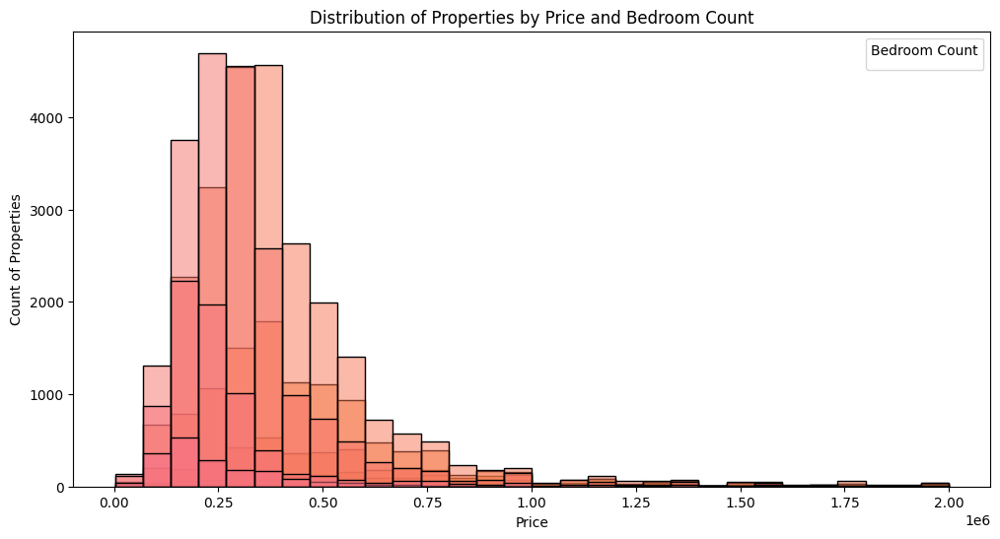

In [48]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Filter the dataset for prices <= 2,000,000
filtered_data = raw_data[raw_data['Price'] <= 2000000]

# Set up the figure and axis
plt.figure(figsize=(12, 6))

# Create histograms for the count of properties for different numbers of bedrooms
sns.histplot(data=filtered_data, x='Price', hue='BedroomCount', multiple='layer', bins=30, palette='husl')

# Add labels and title
plt.xlabel('Price')
plt.ylabel('Count of Properties')
plt.title('Distribution of Properties by Price and Bedroom Count')

# Show the legend
plt.legend(title='Bedroom Count')

# Show the plot
plt.show()


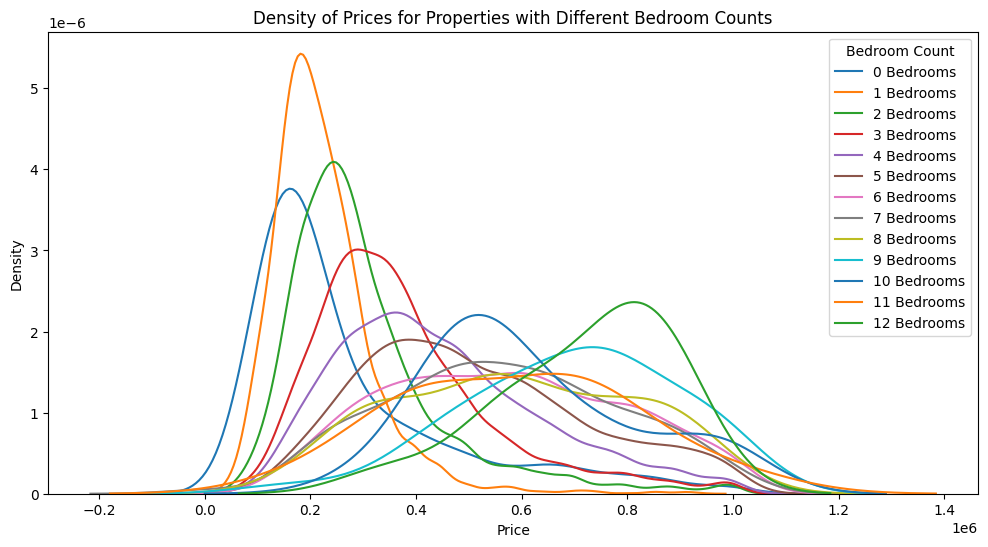

In [76]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt


# Filter the dataset for properties 
filtered_data = raw_data[(raw_data['BedroomCount'] >= 0) & (raw_data['BedroomCount'] <= 12) & (raw_data['Price'] > 0) & (raw_data['Price'] <= 1000000) ]

# Set up the figure and axis
plt.figure(figsize=(12, 6))

# Create kernel density estimate plots for the prices of properties with different bedroom counts
for bedroom_count in range(0, 13):
    sns.kdeplot(data=filtered_data[filtered_data['BedroomCount'] == bedroom_count]['Price'], label=f'{bedroom_count} Bedrooms')

# Add labels and title
plt.xlabel('Price')
plt.ylabel('Density')
plt.title('Density of Prices for Properties with Different Bedroom Counts')

# Show the legend
plt.legend(title='Bedroom Count')

# Show the plot
plt.show()


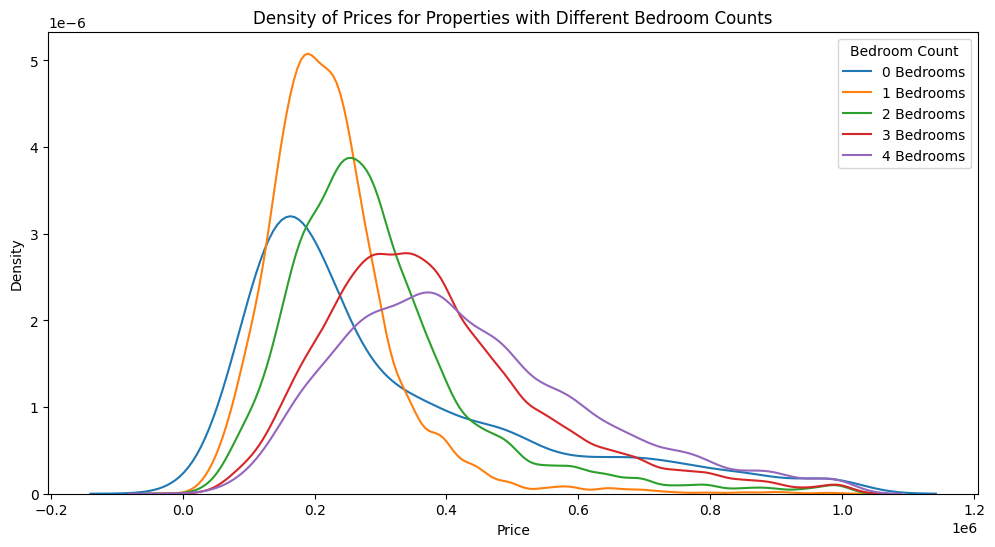

In [61]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt


# Filter the dataset for properties 
filtered_data = raw_data[(raw_data['BedroomCount'] >= 0) & (raw_data['BedroomCount'] <= 4) & (raw_data['Price'] > 0) & (raw_data['Price'] <= 1000000) ]

# Set up the figure and axis
plt.figure(figsize=(12, 6))

# Create kernel density estimate plots for the prices of properties with different bedroom counts
for bedroom_count in range(0, 13):
    sns.kdeplot(data=filtered_data[filtered_data['BedroomCount'] == bedroom_count]['Price'], label=f'{bedroom_count} Bedrooms')

# Add labels and title
plt.xlabel('Price')
plt.ylabel('Density')
plt.title('Density of Prices for Properties with Different Bedroom Counts')

# Show the legend
plt.legend(title='Bedroom Count')

# Show the plot
plt.show()


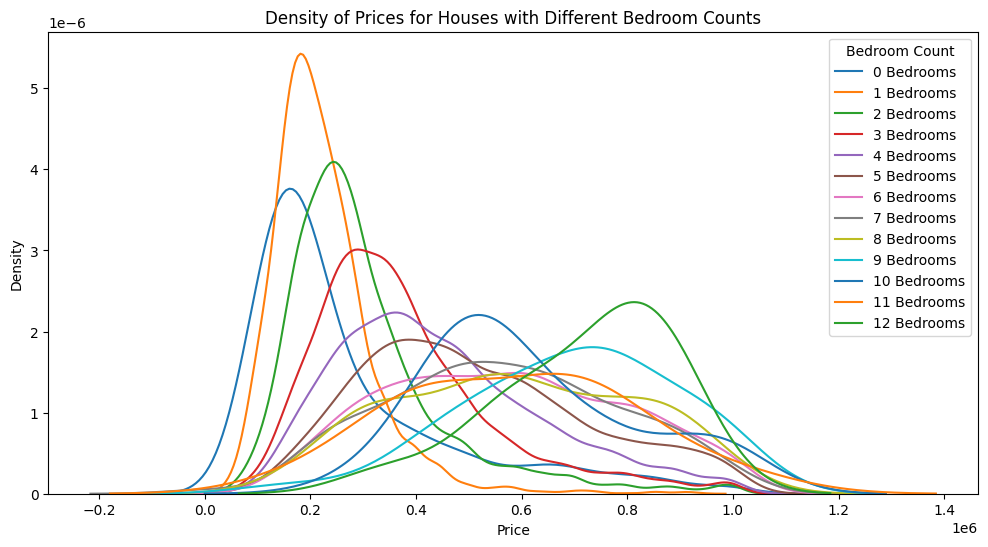

In [78]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Filter the dataset for properties
filtered_data = raw_data[(raw_data['BedroomCount'] >= 0) & 
                          (raw_data['BedroomCount'] <= 12) & 
                          (raw_data['Price'] > 0) & 
                          (raw_data['Price'] <= 1000000)]
 #                         & (raw_data['PropertyType'] == 'HOUSE')]

# Set up the figure and axis
plt.figure(figsize=(12, 6))

# Create kernel density estimate plots for the prices of properties with different bedroom counts
for bedroom_count in range(0, 13):
    sns.kdeplot(data=filtered_data[filtered_data['BedroomCount'] == bedroom_count]['Price'], label=f'{bedroom_count} Bedrooms')

# Add labels and title
plt.xlabel('Price')
plt.ylabel('Density')
plt.title('Density of Prices for Houses with Different Bedroom Counts')

# Show the legend
plt.legend(title='Bedroom Count')

# Show the plot
plt.show()
